# Updates from last version  

* 14/06 - Basic explanation using Kernel SHAP
* 21/06 - improved on linguistic feature names.
* 23/06 - improved features names further by replacing `<UNK>` words
* 26/06 - improved features names further - include POS, CHUNK and predicted NER for raw word features
* 27/06 - split between true false predictions, investgate more where the word is not in embedding.
* 03/07 - trying aic and bic for l1 regularization in Kernel SHAP
* 06/07 - updating reference input for SHAP from `<PAD>` to `<UNK>`
* 22/07 - last epoch model and consistency in result reproducibility
* 22/07 - focus on unknown word entities

In [1]:
%env PYTHONHASHSEED=0

env: PYTHONHASHSEED=0


In [2]:
import pandas as pd
import collections
import pickle

from keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical
from keras.models import load_model
from keras_contrib.layers import CRF
from keras_contrib.losses import crf_loss
from keras_contrib.metrics import crf_accuracy, crf_marginal_accuracy, crf_viterbi_accuracy

from seqeval.metrics import precision_score, recall_score, f1_score, classification_report

from ner_util import pre_process_data_ner, \
                        iob_to_iob2,\
                        SentenceGetter, \
                        format_aux_input, \
                        reduce_sentence_length_by_word, \
                        pred2label, \
                        sent2features, \
                        get_f1

Using TensorFlow backend.


In [3]:
# file paths
validation_iob_tagged_file = '../data/CoNLL-2003/eng.testa'
save_best_weights = '../models/ner/bi_lstm_crf_last_epoch_weights.h5'
# '../models/ner/bi_lstm_crf_weights.h5'
vocab2int_path = '../models/ner_bilstm_crf_train_vocab2int.pkl'
# oh_encoder_path = '../models/ner_bilstm_crf_trained_oh_encoder.pkl'
# standard_transformer_path = '../models/ner_bilstm_crf_trained_standard_transform.pkl'
preprocess_transformer_path = '../models/ner_bilstm_crf_trained_pre-proc_transform.pkl'
tag2idx_path = '../models/ner_bilstm_crf_tag2idx.pkl'
idx2tag_path = '../models/ner_bilstm_crf_idx2tag.pkl'

In [4]:
# other configurations
max_words = 25
max_len = 25
n_tags = 9
num_word_prev = 5
num_word_next = 5

## Load models

In [5]:
with (open(vocab2int_path, "rb")) as _openfile:
    vocab_to_int = pickle.load(_openfile)

In [6]:
with (open(preprocess_transformer_path, "rb")) as _openfile:
    trained_preprocess_transform = pickle.load(_openfile)

In [7]:
with (open(tag2idx_path, "rb")) as _openfile:
    tag2idx = pickle.load(_openfile)

In [8]:
tag2idx

{'B-PER': 0,
 'B-ORG': 1,
 'I-PER': 2,
 'B-MISC': 3,
 'I-ORG': 4,
 'I-LOC': 5,
 'I-MISC': 6,
 'O': 7,
 'B-LOC': 8}

In [9]:
with (open(idx2tag_path, "rb")) as _openfile:
    idx2tag = pickle.load(_openfile)

In [10]:
idx2tag

{0: 'B-PER',
 1: 'B-ORG',
 2: 'I-PER',
 3: 'B-MISC',
 4: 'I-ORG',
 5: 'I-LOC',
 6: 'I-MISC',
 7: 'O',
 8: 'B-LOC'}

In [11]:
import numpy as np
import tensorflow as tf
import random as python_random

# The below is necessary for starting Numpy generated random numbers
# in a well-defined initial state.
np.random.seed(123)

# The below is necessary for starting core Python generated random numbers
# in a well-defined state.
python_random.seed(123)

# The below set_seed() will make random number generation
# in the TensorFlow backend have a well-defined initial state.
# For further details, see:
# https://www.tensorflow.org/api_docs/python/tf/random/set_seed
tf.set_random_seed(1234)

In [12]:
model = load_model(save_best_weights,custom_objects={'CRF': CRF,
                               'crf_loss': crf_loss,
                               'crf_viterbi_accuracy': crf_viterbi_accuracy,
                                'crf_marginal_accuracy':crf_marginal_accuracy,
                                'get_f1': get_f1})

## Hold out dataset

In [13]:
validate_iob_tag_df = pd.read_csv(validation_iob_tagged_file,delimiter=' ',skip_blank_lines=False, 
                                  header = None, names = ['word','pos','chunk','tag'])
validate_iob_tag_df.head()

,word,pos,chunk,tag
0,-DOCSTART-,-X-,O,O
1,NaN,NaN,NaN,NaN
2,CRICKET,NNP,I-NP,O
3,-,:,O,O
4,LEICESTERSHIRE,NNP,I-NP,I-ORG


In [14]:
validate_iob_tagged_df_cleaned = pre_process_data_ner(validate_iob_tag_df)
validate_iob_tagged_df_cleaned.isna().sum()

word            0
pos             0
chunk           0
tag             0
sentence_num    0
doc_num         0
dtype: int64

In [15]:
validate_tag_counts = collections.Counter(validate_iob_tagged_df_cleaned["tag"])
validate_tag_counts

Counter({'O': 42120,
         'I-ORG': 2092,
         'I-LOC': 2094,
         'I-MISC': 1264,
         'I-PER': 3145,
         'B-MISC': 4})

In [16]:
validate_iob_tagged_df_cleaned["iob2_tag"] = iob_to_iob2(validate_iob_tagged_df_cleaned)
validate_iob_tagged_df_cleaned["iob2_chunk"] = iob_to_iob2(validate_iob_tagged_df_cleaned,'chunk')
validate_iob_tagged_df_cleaned.head()

,word,pos,chunk,tag,sentence_num,doc_num,iob2_tag,iob2_chunk
2,CRICKET,NNP,I-NP,O,0,0,O,B-NP
3,-,:,O,O,0,0,O,O
4,LEICESTERSHIRE,NNP,I-NP,I-ORG,0,0,B-ORG,B-NP
5,TAKE,NNP,I-NP,O,0,0,O,I-NP
6,OVER,IN,I-PP,O,0,0,O,B-PP


In [17]:
validate_iob_tagged_df_cleaned.drop(['chunk','tag'], axis = 1, inplace = True)
validate_iob_tagged_df_cleaned.rename(columns = {'iob2_tag':'tag',
                                              'iob2_chunk':'chunk'}, inplace = True)

In [18]:
validate_iob_tagged_df_cleaned_reduced = reduce_sentence_length_by_word(validate_iob_tagged_df_cleaned,
                                                                     max_words,'sentence_num')
validate_iob_tagged_df_cleaned_reduced.shape

(24988, 6)

In [19]:
validate_tag_counts = collections.Counter(validate_iob_tagged_df_cleaned_reduced["tag"])
validate_tag_counts

Counter({'O': 20121,
         'B-ORG': 839,
         'B-LOC': 1180,
         'B-PER': 1008,
         'I-PER': 675,
         'B-MISC': 460,
         'I-MISC': 193,
         'I-LOC': 156,
         'I-ORG': 356})

In [20]:
validate_getter = SentenceGetter(validate_iob_tagged_df_cleaned_reduced)
validate_sentences = validate_getter.sentences

In [21]:
X_validate = [[vocab_to_int[w[0]] if w[0] in vocab_to_int.keys() else vocab_to_int['<UNK>'] for w in s]\
                                                            for s in validate_sentences]
X_validate = pad_sequences(maxlen = max_len, sequences = X_validate, 
                        padding  = 'post', value = vocab_to_int['<PAD>'])
len(X_validate[0])

25

In [22]:
y_validate = [[tag2idx[w[3]] for w in s] for s in validate_sentences]
y_validate = pad_sequences(maxlen = max_len, sequences = y_validate, padding  = 'post', value = tag2idx['O'])

In [23]:
y_validate = [to_categorical(i, num_classes = n_tags) for i in y_validate]

In [24]:
X_aux_validate =  [sent2features(s, num_word_prev, num_word_next, max_len) for s in validate_sentences]
len(X_aux_validate), len(X_aux_validate[0])

(2505, 25)

In [25]:
aux_validate_input, _ = format_aux_input(X_aux_validate, max_len = max_len,
                                     preproc_transform = trained_preprocess_transform)
              #oh_encoder = trained_oh_encoder, standard_transform = trained_standard_transform)
aux_validate_input.shape

D:\Anaconda\envs\XAI_NER\lib\site-packages\pandas\core\frame.py:4244: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  **kwargs


(2505, 25, 2684)

In [26]:
validate_pred = model.predict([X_validate,aux_validate_input], verbose=1)

2505/2505 [==============================] - 11s 4ms/step


In [27]:
validate_pred.shape

(2505, 25, 9)

In [28]:
validate_pred_labels = pred2label(validate_pred, idx2tag)
validate_labels = pred2label(y_validate, idx2tag)

In [29]:
print("F1-score: {:.1%}".format(f1_score(validate_labels, validate_pred_labels)))
print(classification_report(validate_labels, validate_pred_labels))

F1-score: 81.0%
           precision    recall  f1-score   support

      PER       0.72      0.86      0.78      1008
      LOC       0.93      0.85      0.89      1180
     MISC       0.71      0.79      0.75       460
      ORG       0.75      0.81      0.77       839

micro avg       0.79      0.83      0.81      3487
macro avg       0.80      0.83      0.81      3487



## Prepare for explanation

We'll choose observations where there is at least one predicted entity of type location (best performing) or misc (worst performing) and where the probability score is more than 0.95.  
Then we'll need to choose the pair of tags for comparison. The output of this activity should be a data frame containing:
- sentence in raw form
- word index in the sentence for B-LOC / I-LOC tag (having probability more than 0.95)
- whether the prediction is correct
- the other tag for comparison
- word index in the sentence for B-MISC / I-MISC tag (having probability more than 0.95)
- whether the prediction is correct
- the other tag for comparison

In [30]:
import numpy as np
import random

In [31]:
len(validate_iob_tagged_df_cleaned_reduced.sentence_num.unique())

2505

In [32]:
def get_entity_prediction(validate_pred, idx2tag, root_tags = ['PER','LOC','ORG','MISC']):
    pred_df_col_names = [idx2tag.get(id) for id in sorted(idx2tag.keys())]
    entity_prob_arr_list = []
    entity_full_list = root_tags.copy()
    entity_full_list.append('O')
    for val_sent_pred in validate_pred:
        val_sent_pred_df = pd.DataFrame(val_sent_pred, columns= pred_df_col_names)
        #print(val_sent_pred_df.shape)
        val_sent_pred_df['pred_entity'] = val_sent_pred_df.idxmax(axis=1)
        
        entity_prob_dict = {}
        avg_entity_prob_dict = {}
        # for each row:
        for _, row in val_sent_pred_df.iterrows():
        #     if an entity prob is highest:
            if row['pred_entity'] is not 'O':
                for root_tag in root_tags:
                    b_tag = 'B-' + root_tag
                    i_tag = 'I-' + root_tag
                    #if B tag prob is higher:
                    if row[b_tag] > row[i_tag]:
                        # first check  if avg dict any of element left to be added to main dict
                        if avg_entity_prob_dict:
                            avg_list = avg_entity_prob_dict.get(root_tag, [])
                            if len(avg_list) > 0:

                                entity_avg = sum(avg_list)/len(avg_list)
                                # extend the original list by the number of probabilities being averaged
                                entity_prob_dict.setdefault(root_tag, []).extend([entity_avg] * len(avg_list))
                                # reset the list for doing average to emty list
                                avg_entity_prob_dict[root_tag] = []
                        # then add the b-tag prob in the list for averaging
                        avg_entity_prob_dict.setdefault(root_tag, []).append(row[b_tag])
                    else:
                        # if i-tag is higher keep the i-tag porib for averaging
                        avg_entity_prob_dict.setdefault(root_tag, []).append(row[i_tag])
                # need to retain probability of O for averaging
                avg_entity_prob_dict.setdefault('O', []).append(row['O'])
            else: # if row['pred_entity'] is 'O'
                # first check  if avg dict any of element left to be added to main dict
                if avg_entity_prob_dict:
                    # for every root tag calculate seperately
                    for root_tag in root_tags:
                        avg_list = avg_entity_prob_dict.get(root_tag, [])
                        if len(avg_list) > 0:

                            entity_avg = sum(avg_list)/len(avg_list)
                            # extend the original list by the number of probabilities being averaged
                            entity_prob_dict.setdefault(root_tag, []).extend([entity_avg] * len(avg_list))
                            # reset the list for doing average to emty list
                            avg_entity_prob_dict[root_tag] = []

                    # similarly averaging will need to happen for O tag
                    avg_list = avg_entity_prob_dict.get('O', [])
                    if len(avg_list) > 0:
                        entity_avg = sum(avg_list)/len(avg_list)
                        # extend the original list by the number of probabilities being averaged
                        entity_prob_dict.setdefault('O', []).extend([entity_avg] * len(avg_list))
                        # reset the list for doing average to emty list
                        avg_entity_prob_dict['O'] = []
                    # as O is encountered reset avg dict
                    avg_entity_prob_dict = {}
                # for root tags keep the max of B and I tags - no avg
                for root_tag in root_tags:
                    b_tag = 'B-' + root_tag
                    i_tag = 'I-' + root_tag
                    tag_prob = max(row[b_tag],row[i_tag])
                    # if the dict does not have list for the tag, then titialise with a dict
                    entity_prob_dict.setdefault(root_tag, []).append(tag_prob)
                # keep single probability for O tag
                entity_prob_dict.setdefault('O', []).append(row['O'])

            #prev_entity = row['pred_entity']
        # if avg dict hve some residual while processing last row.
        if avg_entity_prob_dict:
            # for every root tag calculate seperately
            for root_tag in root_tags:
                avg_list = avg_entity_prob_dict.get(root_tag, [])
                if len(avg_list) > 0:
                    #if len(avg_list) > 1: ready_to_break = True
                    entity_avg = sum(avg_list)/len(avg_list)
                    # extend the original list by the number of probabilities being averaged
                    entity_prob_dict.setdefault(root_tag, []).extend([entity_avg] * len(avg_list))
                    # reset the list for doing average to emty list
                    avg_entity_prob_dict[root_tag] = []
            # similarly averaging will need to happen for O tag
            avg_list = avg_entity_prob_dict.get('O', [])
            if len(avg_list) > 0:
                entity_avg = sum(avg_list)/len(avg_list)
                # extend the original list by the number of probabilities being averaged
                entity_prob_dict.setdefault('O', []).extend([entity_avg] * len(avg_list))
                # reset the list for doing average to emty list
                avg_entity_prob_dict['O'] = []
        # convert to dataframe
        entity_prob_df = pd.DataFrame(entity_prob_dict)
        entity_prob_df = entity_prob_df[entity_full_list]
        #print(entity_prob_df.columns)
        entity_prob_arr_list.append(entity_prob_df.to_numpy())

    # finally return numpy nd array
    entity_prob_mat = np.array(entity_prob_arr_list) 
    # new id to entity 
    idx2ent = {i: t for i, t in enumerate(entity_full_list)}
    return entity_prob_mat, idx2ent

In [33]:
validate_entity_prob_mat, idx2ent = get_entity_prediction(validate_pred, idx2tag)
validate_true_entity_prob_mat, idx2ent_true = get_entity_prediction(y_validate, idx2tag)
validate_pred.shape, validate_entity_prob_mat.shape, validate_true_entity_prob_mat.shape, len(idx2ent)

((2505, 25, 9), (2505, 25, 5), (2505, 25, 5), 5)

In [34]:
select_tags = ['LOC','MISC']
selection_prob = 0.9
expl_selected_dict ={}

for sent_indx, (pred_i, true_pred_i) in enumerate(zip(validate_entity_prob_mat,validate_true_entity_prob_mat)):
        
        for word_indx, (p, true_p) in enumerate(zip(pred_i, true_pred_i)):
            # predicted
            p_i = np.argmax(p)
            max_p = max(p)
            pred_tag = idx2ent[p_i].replace("PAD", "O")
            
            # actual
            actual_p_i = np.argmax(true_p)
            actual_tag = idx2ent_true[actual_p_i].replace("PAD", "O")
            
            if pred_tag in select_tags and max_p >= selection_prob:
                p_i_next = np.argsort(-p)[1] #bn.argpartition(-p, 0)[1]
                p_next = p[p_i_next]
                pred_tag_next = idx2ent[p_i_next].replace("PAD", "O")
                if expl_selected_dict.get((sent_indx, pred_tag,max_p)) is None:
                    expl_selected_dict[(sent_indx, pred_tag,max_p)] = {'word_indx':[word_indx], 
                                                                    'p_i':p_i, 
                                                                    'p_i_next':p_i_next,
                                                                    'pred_tag_next':pred_tag_next,
                                                                    'p_next':p_next,
                                                                    'is_accurate': actual_tag == pred_tag,
                                                                    'actual_tag': [actual_tag]}
                else:
                    expl_selected_dict[(sent_indx, pred_tag,max_p)]['word_indx'].append(word_indx)
                    expl_selected_dict[(sent_indx, pred_tag,max_p)]['actual_tag'].append(actual_tag)
                    expl_selected_dict[(sent_indx, pred_tag,max_p)]['is_accurate'] = bool(expl_selected_dict[(sent_indx,
                                                                                            pred_tag,max_p)]['is_accurate']* (actual_tag == pred_tag))


len(expl_selected_dict)       

1285

In [35]:
print_dict = {k:v for i,(k,v) in enumerate(expl_selected_dict.items()) if i < 5}
print_dict

{(1, 'LOC', 0.9995254278182983): {'word_indx': [0],
  'p_i': 1,
  'p_i_next': 2,
  'pred_tag_next': 'ORG',
  'p_next': 7.02362522133626e-05,
  'is_accurate': True,
  'actual_tag': ['LOC']},
 (3, 'LOC', 0.9556564688682556): {'word_indx': [5],
  'p_i': 1,
  'p_i_next': 2,
  'pred_tag_next': 'ORG',
  'p_next': 0.04254324734210968,
  'is_accurate': True,
  'actual_tag': ['LOC']},
 (6, 'MISC', 0.9973045786221822): {'word_indx': [2, 3, 4],
  'p_i': 3,
  'p_i_next': 4,
  'pred_tag_next': 'O',
  'p_next': 0.0009111020243229481,
  'is_accurate': True,
  'actual_tag': ['MISC', 'MISC', 'MISC']},
 (7, 'LOC', 0.9995254278182983): {'word_indx': [0],
  'p_i': 1,
  'p_i_next': 2,
  'pred_tag_next': 'ORG',
  'p_next': 7.02362522133626e-05,
  'is_accurate': True,
  'actual_tag': ['LOC']},
 (8, 'MISC', 0.9997628331184387): {'word_indx': [7],
  'p_i': 3,
  'p_i_next': 4,
  'pred_tag_next': 'O',
  'p_next': 3.0428236641455442e-05,
  'is_accurate': True,
  'actual_tag': ['MISC']}}

In [36]:
unkown_word_entity_dict = {}
for k, v_dict in expl_selected_dict.items():   
    word_list = [validate_sentences[k[0]][word_Idx][0] for word_Idx in v_dict['word_indx']]
    if not any(elem in vocab_to_int.keys() for elem in word_list): 
        unkown_word_entity_dict[k] = v_dict    

In [37]:
unkown_word_entity_dict

{(943, 'MISC', 0.9293924570083618): {'word_indx': [0],
  'p_i': 3,
  'p_i_next': 0,
  'pred_tag_next': 'PER',
  'p_next': 0.02475872638024157,
  'is_accurate': False,
  'actual_tag': ['O']},
 (1160, 'MISC', 0.9211748838424683): {'word_indx': [5],
  'p_i': 3,
  'p_i_next': 1,
  'pred_tag_next': 'LOC',
  'p_next': 0.05621861293911934,
  'is_accurate': False,
  'actual_tag': ['O']},
 (1272, 'LOC', 0.928786039352417): {'word_indx': [0],
  'p_i': 1,
  'p_i_next': 2,
  'pred_tag_next': 'ORG',
  'p_next': 0.015414469875395298,
  'is_accurate': True,
  'actual_tag': ['LOC']},
 (1883, 'MISC', 0.9708071947097778): {'word_indx': [16],
  'p_i': 3,
  'p_i_next': 4,
  'pred_tag_next': 'O',
  'p_next': 0.008481945861660733,
  'is_accurate': False,
  'actual_tag': ['O']},
 (2250, 'MISC', 0.95517897605896): {'word_indx': [8],
  'p_i': 3,
  'p_i_next': 4,
  'pred_tag_next': 'O',
  'p_next': 0.041890859603881836,
  'is_accurate': False,
  'actual_tag': ['O']},
 (2313, 'MISC', 0.9632401466369629): {'word_

In [38]:
sent_getter_id_dict = {" ".join([x[0] for x in text]):i for i, text in enumerate(validate_sentences)}

In [39]:
sent_word_getter_id_dict = {i:{(j,words[0]):words for j, words in enumerate(text)} for i, text in enumerate(validate_sentences)}

In [40]:
sent_word_getter_id_dict[10]

{(0, 'Somerset'): ('Somerset', 'NNP', 'B-NP', 'B-ORG'),
 (1, '83'): ('83', 'CD', 'I-NP', 'O'),
 (2, 'and'): ('and', 'CC', 'I-NP', 'O'),
 (3, '174'): ('174', 'CD', 'I-NP', 'O'),
 (4, '('): ('(', '(', 'O', 'O'),
 (5, 'P.'): ('P.', 'NNP', 'B-NP', 'B-PER'),
 (6, 'Simmons'): ('Simmons', 'NNP', 'I-NP', 'I-PER'),
 (7, '4-38'): ('4-38', 'CD', 'I-NP', 'O'),
 (8, ')'): (')', ')', 'O', 'O'),
 (9, ','): (',', ',', 'O', 'O'),
 (10, 'Leicestershire'): ('Leicestershire', 'NNP', 'B-NP', 'B-ORG'),
 (11, '296'): ('296', 'CD', 'I-NP', 'O'),
 (12, '.'): ('.', '.', 'O', 'O')}

## Kernel SHAP for NER

In [41]:
from explanation_util import NER_KSHAPExplainerGenerator
from matplotlib import pyplot as plt

In [42]:
KSHAP_explainer_generator = NER_KSHAPExplainerGenerator(model, vocab_to_int, tag2idx, max_len, 
                                            sent_getter_id_dict, sent_word_getter_id_dict,
                                            validate_sentences, trained_preprocess_transform,
                                                       num_word_next = num_word_next,
                num_word_prev = num_word_prev)

In [43]:
# changed from <PAD>
ref_text = ("<UNK> " * max_words).strip()
ref_flat_input, _ = KSHAP_explainer_generator.preprocess([ref_text])
ref_flat_input.shape #, flat_input_list.shape


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


1/1 [==============================] - 0s 270ms/step


(1, 67125)

### Kernel SHAP explanation

In [44]:
import shap
from explanation_validation_util import visualize_kernel_shap_explanation

## LIME set up for NER explanation

In [45]:
from lime.lime_text import LimeTextExplainer
from explanation_util import NER_LIMEExplainerGenerator
from explanation_validation_util import visualize_LIME_explanations

In [46]:
LIME_explainer_generator = NER_LIMEExplainerGenerator(model, vocab_to_int, tag2idx, max_len, 
                                            sent_getter_id_dict, sent_word_getter_id_dict,
                                            validate_sentences, trained_preprocess_transform,
                                                     num_word_next = num_word_next,
                num_word_prev = num_word_prev)

In [47]:
list(idx2ent.values())

['PER', 'LOC', 'ORG', 'MISC', 'O']

In [48]:
# classes and the entity names
LIME_explainer = LimeTextExplainer(class_names=list(idx2ent.values()),bow = False) #, split_expression= " ")


## Visualization

In [49]:
visualize_LIME_explanations(LIME_explainer_generator, LIME_explainer, 
                            validate_sentences, unkown_word_entity_dict)


Sentence for explanation: Missing German girl found alive at Dutch campsite .
Word for explanation: Missing
Predicted named entity for the words: MISC
Actual named entity for the words: O


split() requires a non-empty pattern match.

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Sentence for explanation: The plane smashed into a snow-capped mountain on the Arctic island of Spitzbergen on Thursday , just east of Longyear .
Word for explanation: snow-capped
Predicted named entity for the words: MISC
Actual named entity for the words: O


split() requires a non-empty pattern match.

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Sentence for explanation: The victory against Japan marked the Fed Cup debut of Monica Seles , who became a naturalised U.S. citizen in 1994 .
Word for explanation: naturalised
Predicted named entity for the words: MISC
Actual named entity for the words: O


split() requires a non-empty pattern match.

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Sentence for explanation: Moslems were driven from the village during the 43- month Bosnian war and most of their houses were destroyed .
Word for explanation: 43-
Predicted named entity for the words: MISC
Actual named entity for the words: O


split() requires a non-empty pattern match.

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Sentence for explanation: The war claimed more than 125,000 lives in the southern Mindanao island over a quarter of a century .
Word for explanation: Mindanao
Predicted named entity for the words: MISC
Actual named entity for the words: LOC


split() requires a non-empty pattern match.

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Sentence for explanation: Missing German girl found alive at Dutch campsite .
Word for explanation: Missing
Predicted named entity for the words: MISC
Actual named entity for the words: O
1/1 [==============================] - 0s 82ms/step



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Force plot for entity MISC:


Top 10 features and SHAP values for entity MISC:


,3
German>1>JJ>MISC,4.094007
girl>2>NN>O,0.697345
Dutch>6>JJ>MISC,0.370279
.>8>.>O,0.096887


Multiple output decision ploit highlighting entity MISC and PER:


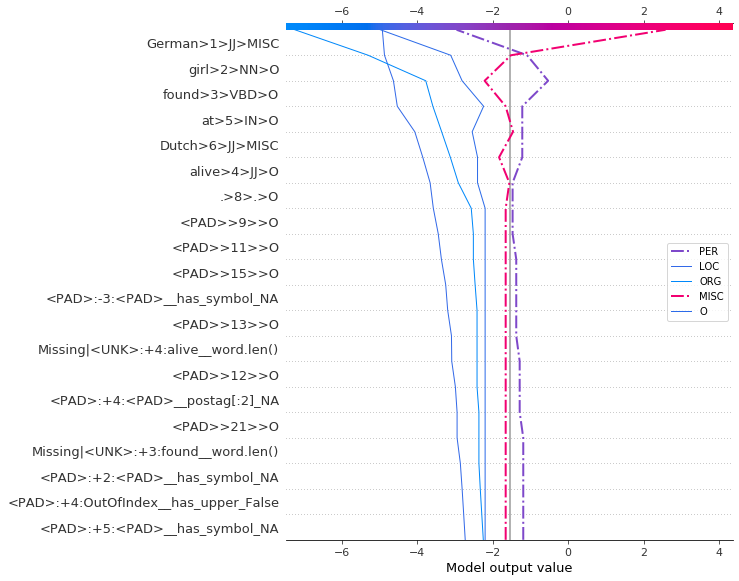

Summary plot with top 10 features and for entity MISC:


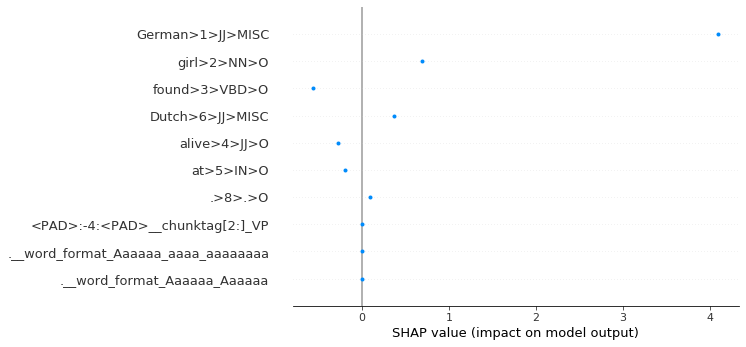

None

Summary plot for all classes together:


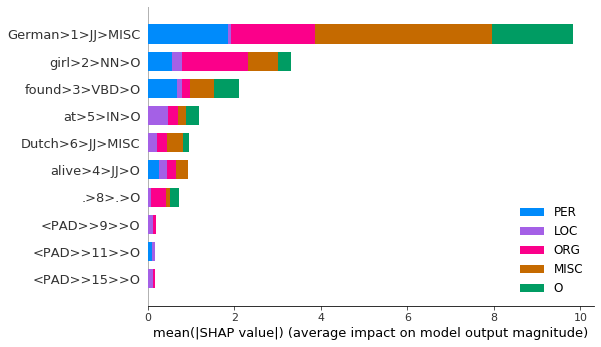

None

top 10 fetures and SHAP values for all classes together


,PER,LOC,ORG,MISC,O
German>1>JJ>MISC,-1.867820,-0.057038,-1.940389,4.094007,-1.861682
girl>2>NN>O,-0.557117,-0.236926,-1.524651,0.697345,-0.301146
found>3>VBD>O,0.684686,-0.102156,-0.188474,-0.556422,-0.569702
at>5>IN>O,0.000000,-0.463475,-0.232504,-0.196263,0.302525
Dutch>6>JJ>MISC,0.000000,-0.211022,-0.229889,0.370279,-0.141534
...,...,...,...,...,...
<PAD>__has_symbol_False,0.000000,-0.002288,0.000000,0.000000,0.000000
<PAD>:-5:<PAD>__postag_NA,0.000000,-0.000809,0.000000,0.000000,0.000000
<PAD>__word_format_summary_NA,0.000000,-0.000542,0.000000,0.000000,0.000000
<PAD>:+4:<PAD>__chunktag[2:]_NA,0.000000,0.000522,0.000000,0.000000,0.000000



Sentence for explanation: The plane smashed into a snow-capped mountain on the Arctic island of Spitzbergen on Thursday , just east of Longyear .
Word for explanation: snow-capped
Predicted named entity for the words: MISC
Actual named entity for the words: O



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


1/1 [==============================] - 0s 273ms/step



Force plot for entity MISC:


Top 10 features and SHAP values for entity MISC:


,3
a>4>DT>O,2.616455
mountain>6>NN>O,0.492781
into>3>IN>O,0.467877
The>0>DT>O,0.298598
Arctic>9>NNP>MISC,0.294385
Spitzbergen>12>NNP>LOC,0.231068
Thursday>14>NNP>O,0.188387
smashed>2>VBD>O,0.137129
island>10>NN>O,0.116938
<PAD>__EOS-2_NA,0.026376


Multiple output decision ploit highlighting entity MISC and LOC:


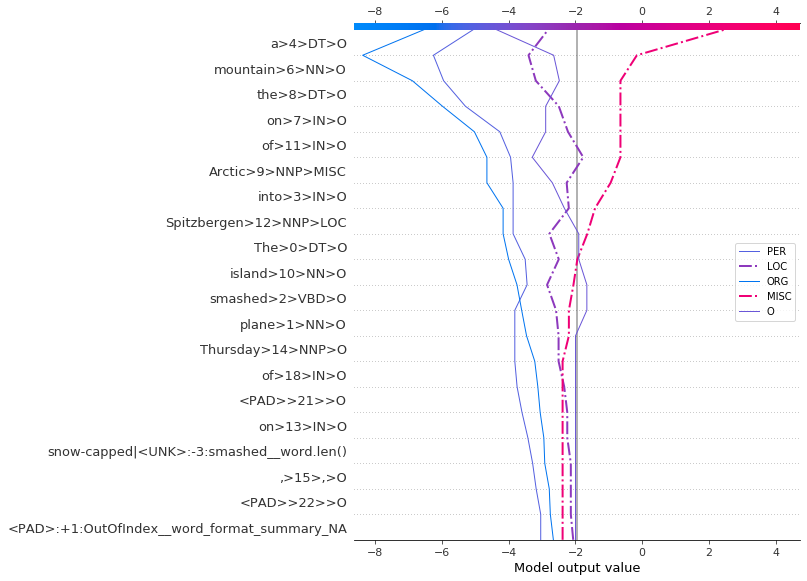

Summary plot with top 10 features and for entity MISC:


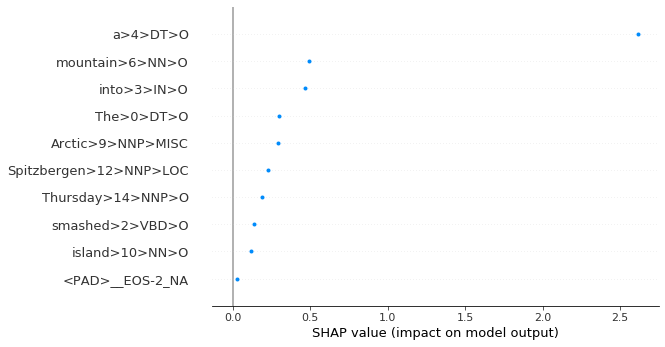

None

Summary plot for all classes together:


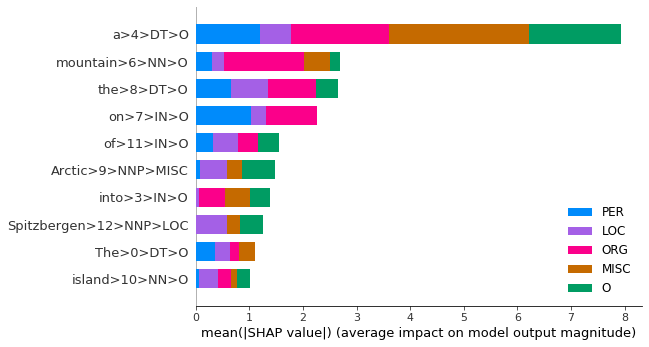

None

top 10 fetures and SHAP values for all classes together


,PER,LOC,ORG,MISC,O
a>4>DT>O,1.189180,0.586723,1.831715,2.616455,-1.706694
mountain>6>NN>O,-0.306264,-0.219949,-1.491264,0.492781,-0.170616
the>8>DT>O,-0.653578,-0.688639,-0.902126,0.000000,0.409770
on>7>IN>O,-1.030815,-0.274745,-0.956421,0.000000,0.000000
of>11>IN>O,-0.322263,-0.458334,-0.375178,0.000000,0.402064
...,...,...,...,...,...
.:+3:<PAD>__word_format_summary_NA,0.000000,0.000000,-0.010695,0.000000,0.000000
<PAD>:-1:.__word.istitle()_False,0.000000,0.000000,-0.010572,0.000000,0.000000
on__has_symbol_True,0.000000,0.000000,-0.010557,0.000000,0.000000
smashed:+1:into__postag_DT,0.000000,0.000000,-0.010260,0.000000,0.000000



Sentence for explanation: The victory against Japan marked the Fed Cup debut of Monica Seles , who became a naturalised U.S. citizen in 1994 .
Word for explanation: naturalised
Predicted named entity for the words: MISC
Actual named entity for the words: O



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


1/1 [==============================] - 0s 290ms/step



Force plot for entity MISC:


Top 10 features and SHAP values for entity MISC:


,3
a>15>DT>O,1.843573
U.S.>17>NNP>LOC,1.148813
1994>20>CD>O,0.544920
citizen>18>NN>O,0.523530
became>14>VBD>O,0.362235
of>9>IN>O,0.273230
.>21>.>O,0.225671
",>12>,>O",0.142887
Cup>7>NNP>MISC,0.137514
naturalised|<UNK>:-5:Seles__word.len(),0.101525


Multiple output decision ploit highlighting entity MISC and O:


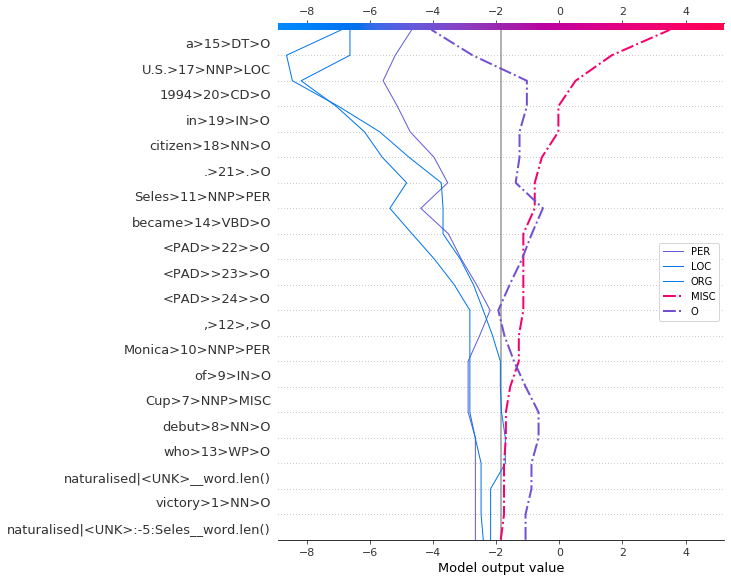

Summary plot with top 10 features and for entity MISC:


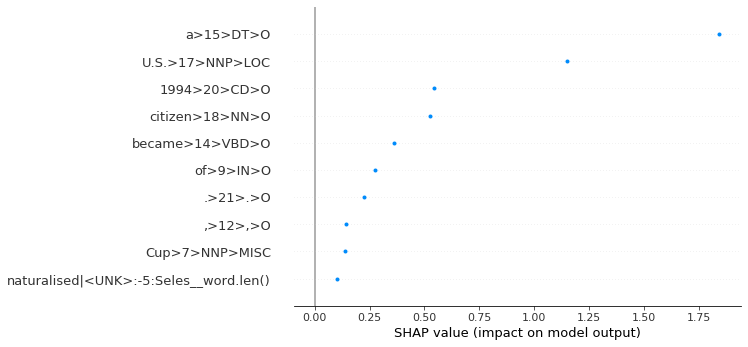

None

Summary plot for all classes together:


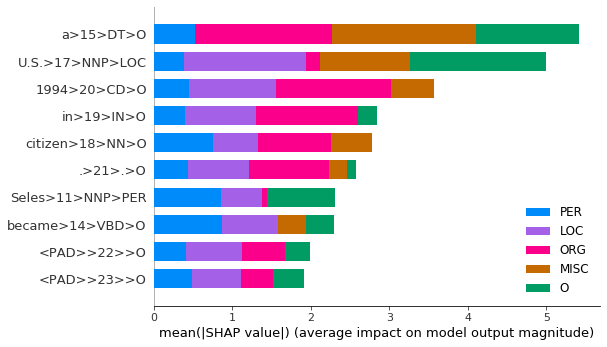

None

top 10 fetures and SHAP values for all classes together


,PER,LOC,ORG,MISC,O
a>15>DT>O,0.522145,0.000000,1.743465,1.843573,-1.304369
U.S.>17>NNP>LOC,0.384978,1.548167,-0.185853,1.148813,-1.723048
1994>20>CD>O,-0.451792,-1.109759,-1.460403,0.544920,0.000000
in>19>IN>O,-0.404553,-0.896698,-1.304368,0.000000,0.232476
citizen>18>NN>O,-0.757521,-0.565696,-0.934174,0.523530,0.000000
.>21>.>O,-0.434281,-0.773868,-1.022673,0.225671,0.122673
Seles>11>NNP>PER,0.852955,0.532403,-0.054829,0.000000,-0.863966
became>14>VBD>O,-0.873981,-0.702693,0.000000,0.362235,0.352260
<PAD>>22>>O,-0.413544,-0.713288,-0.551297,0.000000,0.313656
<PAD>>23>>O,-0.481546,-0.626401,-0.414681,0.000000,0.389192



Sentence for explanation: Moslems were driven from the village during the 43- month Bosnian war and most of their houses were destroyed .
Word for explanation: 43-
Predicted named entity for the words: MISC
Actual named entity for the words: O



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


1/1 [==============================] - 0s 268ms/step



Force plot for entity MISC:


Top 10 features and SHAP values for entity MISC:


,3
the>7>DT>O,2.342986
Bosnian>10>JJ>MISC,2.099291
village>5>NN>O,0.804787
the>4>DT>O,0.604077
from>3>IN>O,0.400319
war>11>NN>O,0.099165
Moslems>0>NNS>MISC,0.085553


Multiple output decision ploit highlighting entity MISC and O:


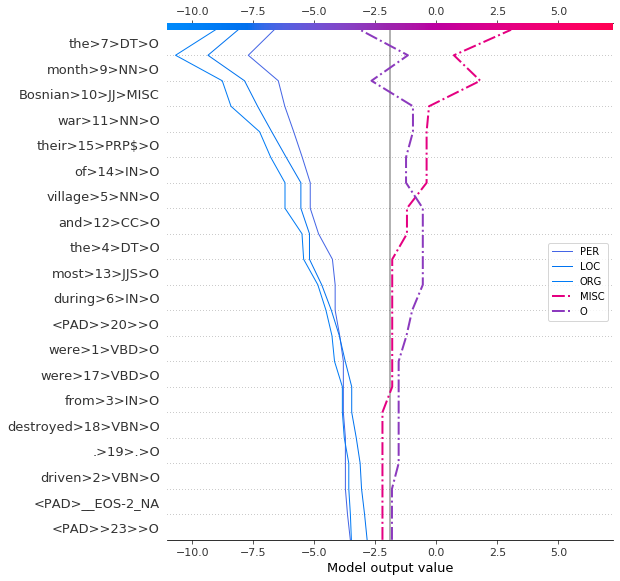

Summary plot with top 10 features and for entity MISC:


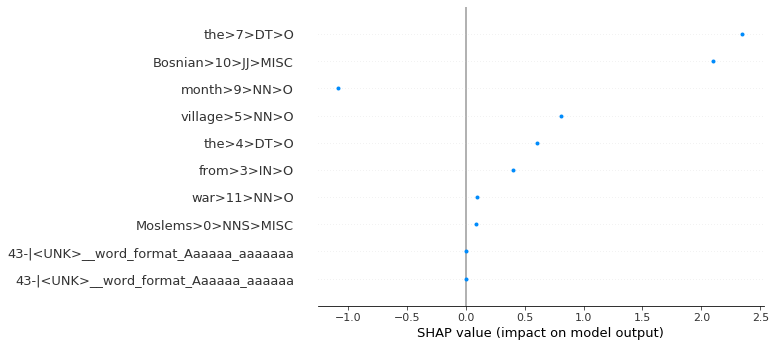

None

Summary plot for all classes together:


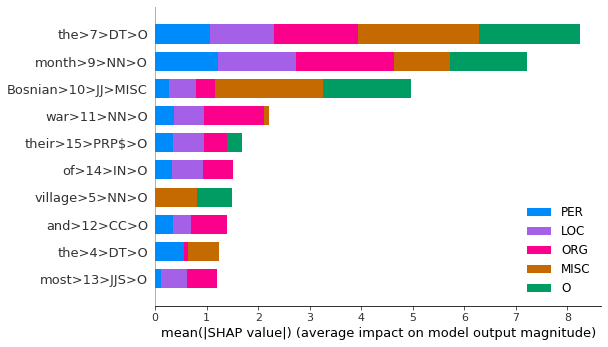

None

top 10 fetures and SHAP values for all classes together


,PER,LOC,ORG,MISC,O
the>7>DT>O,1.063335,1.239426,1.639453,2.342986,-1.962421
month>9>NN>O,-1.228925,-1.498257,-1.913937,-1.079986,1.493870
Bosnian>10>JJ>MISC,-0.266947,-0.536036,-0.357337,2.099291,-1.700719
war>11>NN>O,-0.366070,-0.579040,-1.173699,0.099165,0.000000
their>15>PRP$>O,-0.349440,-0.590889,-0.454604,0.000000,0.283820
...,...,...,...,...,...
<PAD>:-1:<PAD>__word.isdigit()_NA,0.000000,0.000000,0.014742,0.000000,0.000000
.:-4:their__word_format_summary_NA,0.000000,0.000000,-0.013757,0.000000,0.000000
<PAD>__BOS+2_NA,-0.011512,0.000000,0.000000,0.000000,0.000000
the:+5:month__word.len(),0.000000,-0.008252,0.000000,0.000000,0.000000



Sentence for explanation: The war claimed more than 125,000 lives in the southern Mindanao island over a quarter of a century .
Word for explanation: Mindanao
Predicted named entity for the words: MISC
Actual named entity for the words: LOC



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


1/1 [==============================] - 0s 265ms/step



Force plot for entity MISC:


Top 10 features and SHAP values for entity MISC:


,3
southern>9>JJ>O,2.558537
a>13>DT>O,0.608598
over>12>IN>O,0.377892
more>3>JJR>O,0.337786
quarter>14>NN>O,0.295680
in>7>IN>O,0.291378
the>8>DT>O,0.207736
a>16>DT>O,0.206366
war>1>NN>O,0.155836
"Mindanao|<UNK>:-5:125,000|<UNK>__word.len()",0.107759


Multiple output decision ploit highlighting entity MISC and LOC:


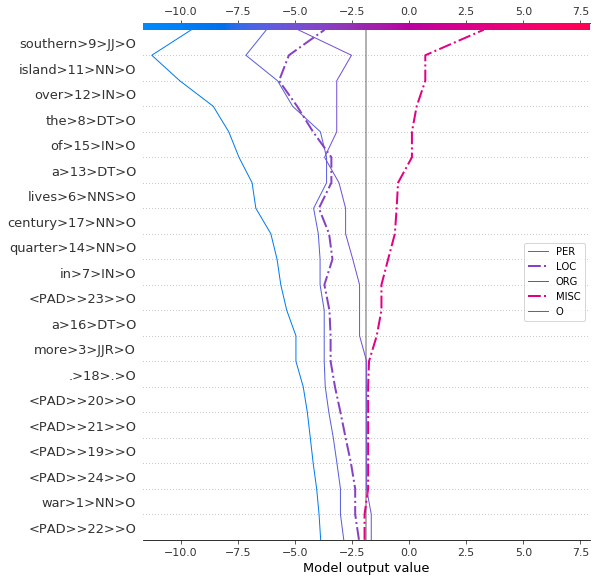

Summary plot with top 10 features and for entity MISC:


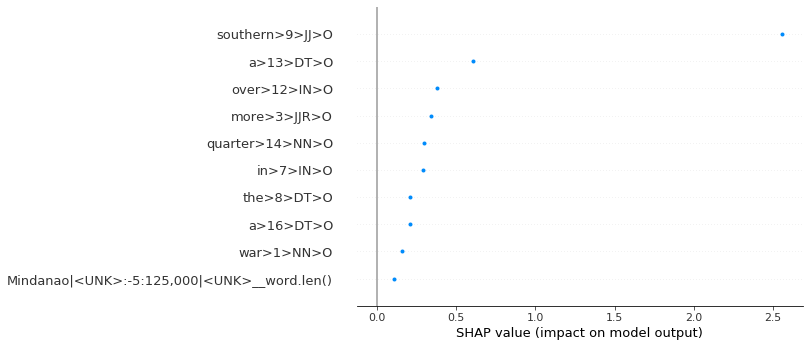

None

Summary plot for all classes together:


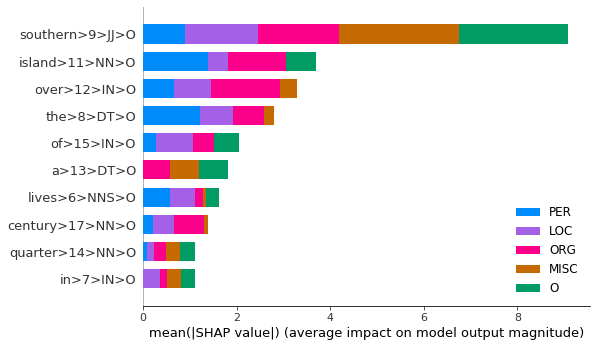

None

top 10 fetures and SHAP values for all classes together


,PER,LOC,ORG,MISC,O
southern>9>JJ>O,0.899057,1.562283,1.733121,2.558537,-2.336197
island>11>NN>O,-1.387017,0.431176,-1.226061,0.000000,0.646244
over>12>IN>O,-0.659645,-0.792035,-1.464518,0.377892,0.000000
the>8>DT>O,-1.214760,-0.696647,-0.679037,0.207736,0.000000
of>15>IN>O,-0.272058,-0.803065,-0.448039,0.000000,0.532360
...,...,...,...,...,...
Mindanao|<UNK>:-3:in__word.len(),0.000000,0.000000,-0.003362,0.000000,0.000000
<PAD>:+2:OutOfIndex__has_upper_NA,0.000000,0.000000,-0.003349,0.000000,0.000000
<PAD>:-2:<PAD>__word.isdigit()_NA,0.002254,0.000000,0.000000,0.000000,0.000000
quarter:+5:<PAD>__chunktag[2:]_NA,0.000000,0.000000,0.001685,0.000000,0.000000


In [50]:
shap.initjs()
# explanation for LOC close predictions
visualize_kernel_shap_explanation(KSHAP_explainer_generator, ref_flat_input,validate_sentences, 
                                  idx2ent,unkown_word_entity_dict)